In [1]:
import pandas as pd
from dataprep.eda.distribution import plot
from dataprep.eda import create_report
import numpy as np
import warnings
warnings.filterwarnings('ignore',category=FutureWarning)

# Data Checking

## Objective
1. Focus on removing unusable data
2. Check typo
3. Generalize if possible

  0%|          | 0/1532 [00:00<?, ?it/s]

c:\Users\Rifqi-Yunus\anaconda3\Lib\site-packages\dask\core.py:121: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
c:\Users\Rifqi-Yunus\anaconda3\Lib\site-packages\dask\core.py:121: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))


DataPrep Report
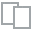
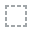
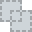
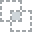
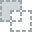
...
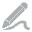
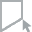
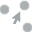
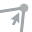
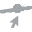

In [2]:
# Kalimantan Selatan
path_kalsel = 'data\KALSEL.xlsx'

df = pd.read_excel(path_kalsel)
create_report(df)


In [3]:
df = df[['JAM DOWN', 'START DATE','KAB/KOTA', 'ROOTCAUSE', 'CUSTOMER', 'INCIDENT ID', 'TANGGAL PENGERJAAN', 'JAM UP', 'STATUS']]
df.columns = df.columns.str.lower().str.replace(' ', '_')
df.head(20)

,jam_down,start_date,kab/kota,rootcause,customer,incident_id,tanggal_pengerjaan,jam_up,status
0,<NA>,2023-10-01,Kota Banjar Baru,Core Crack/Bending,MUHAMAD SABIANTORO,23103100038,2023-10-01,19.30,✅
1,<NA>,2023-10-01,Kota Banjar Baru,Putus Kabel,NABILA SYAKIEB,23103100145,2023-10-02,10.47,✅
2,<NA>,2023-10-01,Kota Banjar Baru,Bad Performance Perangkat,"VERDI KURNIAWAN, SE",23103100220,2023-10-02,12.10,✅
3,<NA>,2023-10-01,Kota Banjarmasin,Bad Performance Perangkat,DINDA MAULIDINA,23103100296,2023-10-02,12.57,✅
4,<NA>,2023-10-01,Kota Banjar Baru,Kabel DW Rusak,M.RAMADHANI PLNT PLNT,23103100068,2023-10-02,13.00,✅
5,<NA>,2023-10-01,Kota Banjar Baru,Kabel DW Rusak,YULIANA SETYAWATI,23103100195,2023-10-02,13.02,✅
6,<NA>,2023-10-01,Kota Banjar Baru,FAT Down,AKHMAD FAJAR SURYAWARDHANA,23103100070,2023-10-02,16.00,✅
7,<NA>,2023-10-01,Kota Banjar Baru,Kabel DW Rusak,FIRDI SEPTIADY SEPTIADY,23103100459,2023-10-02,17.00,✅
8,<NA>,2023-10-02,Kota Banjar Baru,Putus Kabel,YUSDA NOOR IMANSYAH,23103100497,2023-10-03,09.09,✅
9,<NA>,2023-10-03,KOTA BANJARBARU,Core Crack/Bending,AKHMAD RENALDI,23103100646,2023-10-03,09.48,✅


### Clean Jam dan Tanggal
Cek row with wrong data format

In [4]:
import re
hasil = []

df['jam_down'] = df['jam_down'].str.strip().str.replace('.',':').str.replace(':::',':').str.replace('::',':').str.replace(',',':').str.replace('l',':')
df['jam_up'] = df['jam_up'].str.strip().str.replace('.',':').str.replace('::',':').str.replace(',',':').str.replace(' ','')

# for jam in df.jam_down:
#     hasil_re = re.search(r'\d{2}:\d{2}$',str(jam))
#     if hasil_re == None:
#         hasil.append(jam)
# set(hasil)
for entry in df['jam_down']:
    try:
        pd.to_datetime(entry, format='%H:%M')
    except ValueError:
        print(f"Problematic entry: {entry}")

# df_cleaned.loc[df_cleaned['jam_down'] =='18:3',['jam_down']] = '18:30'
# df_cleaned.loc[df_cleaned['jam_down'] =='7:20',['jam_down']] = '07:20'
# df_cleaned.loc[df_cleaned['jam_down'] =='Z',['jam_down']] = np.nan

Problematic entry: Z
Problematic entry: 1632


## Clean Final

In [5]:
# Fungsi untuk membersihkan dan memformat ulang DataFrame
def clean_data(df):
    # Filter baris dengan ikon checklist hijau pada kolom 'STATUS'
    df_cleaned = df[df['status'] == '✅'].copy()

    # Mengisi nilai NaN pada 'jam_down' dengan "00.00" dan pada 'jam_up' dengan "20.00"
    df_cleaned['jam_down'].fillna("00.00", inplace=True)
    df_cleaned['jam_up'].fillna("20.00", inplace=True)

    # Memastikan semua entri pada 'kab/kota' adalah string dan memformatnya menjadi huruf kapital awal
    df_cleaned['kab/kota'] = df_cleaned['kab/kota'].astype(str).str.title().str.strip()

    return df_cleaned

# Menerapkan fungsi pembersihan pada DataFrame
df_cleaned = clean_data(df)

# Penyesuaian dan koreksi lebih lanjut
corrections = {
    'Tabalong' : 'Tanjung',
    'Banjar Masin' : 'Kota Banjarmasin',
    'Tanjiung' : 'Tanjung',
    'Kota Banjar Masin Utara' : 'Kota Banjarmasin',
    'Kota Banjar Baru' : 'Kota Banjarbaru',
    'Banjarmasin Utara' : 'Kota Banjarmasin',
    'Banjarmasin' : 'Kota Banjarmasin',
    'Martapura' : 'Banjar',
    'Banjarbaru Utara' : 'Banjar',
    'Banjamasin' : 'Kota Banjarmasin',
    'Kait Kait' : 'Tanah Laut',
    'Bati Bati' : 'Tanah Laut',
    'Kab. Tanah Laut' : 'Tanah Laut',
    'Kab Banjar' : 'Banjar',
    'Kab. Banjar' : 'Banjar',
    'Banjarbaru' : 'Kota Banjarbaru', 
    'Kab. Hulu Sungai Selatan' : 'Hulu Sungai Selatan',
    'Kab. Barito Kuala' : 'Barito Kuala',
    'Nan': None}

df_cleaned['kab/kota'] = df_cleaned['kab/kota'].replace(corrections)
df_cleaned['kab/kota'] = df_cleaned['kab/kota'].str.strip()

# Mengganti nilai None dengan 'NaN' atau np.nan berdasarkan tipe data kolom
def replace_none_values(df):
    for col in df.columns:
        if df[col].dtype == 'object':  # untuk kolom string
            df[col] = df[col].replace({None: 'NaN'})
        elif np.issubdtype(df[col].dtype, np.number):  # untuk kolom numerik
            df[col] = df[col].replace({None: np.nan})
    return df

df_cleaned = replace_none_values(df_cleaned)

# Drop some false row
rows_to_drop = df_cleaned[df_cleaned['incident_id'] == 'soon']
df_cleaned = df_cleaned.drop(rows_to_drop.index)

# Memformat ulang jam_down dan jam_up
df_cleaned['jam_down'] = df_cleaned['jam_down'].str.strip().str.replace('.',':').str.replace(':::',':').str.replace('::',':').str.replace(',',':').str.replace('l',':')
df_cleaned['jam_up'] = df_cleaned['jam_up'].str.strip().str.replace('.',':').str.replace('::',':').str.replace(',',':').str.replace(' ','')

# Correction Time Values
df_cleaned.loc[df_cleaned['jam_down'] =='1632',['jam_down']] = '16:32'
df_cleaned.loc[df_cleaned['jam_down'] =='8:49',['jam_down']] = '08:49'
df_cleaned.loc[df_cleaned['jam_down'] =='Z',['jam_down']] = '00:00'
df_cleaned.loc[df_cleaned['jam_up'] =='18:3',['jam_up']] = '18:30'
df_cleaned.loc[df_cleaned['jam_up'] =='7:20',['jam_up']] = '07:20'

# Mengonversi jam_down dan jam_up menjadi format waktu
df_cleaned['jam_down'] = pd.to_datetime(df_cleaned['jam_down'], format='%H:%M').dt.time
df_cleaned['jam_up'] = pd.to_datetime(df_cleaned['jam_up'], format='%H:%M').dt.time

# Menggabungkan tanggal dengan waktu
df_cleaned['time_down'] = pd.to_datetime(df_cleaned['start_date'].astype(str) + ' ' + df_cleaned['jam_down'].astype(str), format='%Y-%m-%d %H:%M:%S', errors='coerce')
df_cleaned['time_up'] = pd.to_datetime(df_cleaned['tanggal_pengerjaan'].astype(str) + ' ' + df_cleaned['jam_up'].astype(str), format='%Y-%m-%d %H:%M:%S', errors='coerce')

df_cleaned.drop(columns=['jam_down', 'jam_up','start_date', 'tanggal_pengerjaan', 'status'], inplace=True)   
df_cleaned['customer-kota'] = df_cleaned['customer'].astype(str) + ' ' + df_cleaned['kab/kota'].astype(str)
df_cleaned

,kab/kota,rootcause,customer,incident_id,time_down,time_up,customer-kota
0,Kota Banjarbaru,Core Crack/Bending,MUHAMAD SABIANTORO,23103100038,2023-10-01 00:00:00,2023-10-01 19:30:00,MUHAMAD SABIANTORO Kota Banjarbaru
1,Kota Banjarbaru,Putus Kabel,NABILA SYAKIEB,23103100145,2023-10-01 00:00:00,2023-10-02 10:47:00,NABILA SYAKIEB Kota Banjarbaru
2,Kota Banjarbaru,Bad Performance Perangkat,"VERDI KURNIAWAN, SE",23103100220,2023-10-01 00:00:00,2023-10-02 12:10:00,"VERDI KURNIAWAN, SE Kota Banjarbaru"
3,Kota Banjarmasin,Bad Performance Perangkat,DINDA MAULIDINA,23103100296,2023-10-01 00:00:00,2023-10-02 12:57:00,DINDA MAULIDINA Kota Banjarmasin
4,Kota Banjarbaru,Kabel DW Rusak,M.RAMADHANI PLNT PLNT,23103100068,2023-10-01 00:00:00,2023-10-02 13:00:00,M.RAMADHANI PLNT PLNT Kota Banjarbaru
...,...,...,...,...,...,...,...
859,Kota Banjarbaru,Kabel DW Rusak,ENDANG SETIAWATI,23113108749,2023-11-30 12:06:00,2023-11-30 16:02:00,ENDANG SETIAWATI Kota Banjarbaru
860,Kota Banjarmasin,Core Crack/Bending,FAHRIANI,23113108679,2023-11-30 08:53:00,2023-11-30 11:36:00,FAHRIANI Kota Banjarmasin
861,Tanah Laut,Core Crack/Bending,RESTU NANDA PRATAMA,23113108715,2023-11-30 10:14:00,2023-12-01 10:32:00,RESTU NANDA PRATAMA Tanah Laut
862,Kota Banjarmasin,Kabel DW Rusak,SAIPUL RAHMAN,23113108935,2023-11-30 22:07:00,2023-12-01 14:10:00,SAIPUL RAHMAN Kota Banjarmasin


  0%|          | 0/592 [00:00<?, ?it/s]

c:\Users\Rifqi-Yunus\anaconda3\Lib\site-packages\dask\core.py:121: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))


DataPrep Report
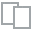
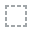
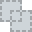
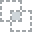
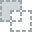
...
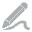
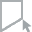
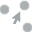
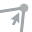
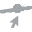

In [6]:
create_report(df_cleaned)

In [8]:
df_cleaned.to_excel('data/KALSEL_clean.xlsx')